# Random Forest Model + Explainable AI Techniques (XAI)

## Data Preparation

In [1]:
import pandas as pd
import numpy as np
import joblib
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split

Load Train Dataset

In [2]:
df_train = pd.read_csv("../0_Datasets/IoMT_AI_IDS/Flows/train.csv")

In [3]:
display(df_train)

,fwd_pkts_tot,bwd_pkts_tot,fwd_data_pkts_tot,bwd_data_pkts_tot,fwd_pkts_per_sec,bwd_pkts_per_sec,flow_pkts_per_sec,down_up_ratio,fwd_header_size_tot,fwd_header_size_min,...,flow_pkts_payload.max,flow_pkts_payload.tot,flow_pkts_payload.avg,flow_pkts_payload.std,fwd_subflow_pkts,bwd_subflow_pkts,fwd_subflow_bytes,bwd_subflow_bytes,traffic,is_attack
0,-0.674434,-0.621972,-0.450908,-0.746950,-0.572718,-0.467121,-0.530517,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
1,-0.722124,-0.725850,-0.546365,-0.746950,-0.572239,-0.466783,-0.530104,0.232052,-0.727991,0.002967,...,-0.517239,-0.824912,-0.557857,-0.527991,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
2,-0.674434,-0.621972,-0.450908,-0.746950,-0.572705,-0.467112,-0.530505,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
3,-0.674434,-0.621972,-0.450908,-0.746950,-0.572649,-0.467072,-0.530456,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
4,-0.865193,-0.933607,-0.928195,-0.746950,-0.054334,0.273648,0.143245,2.515023,-0.871428,0.002967,...,-0.519508,-0.829911,-0.565532,-0.531550,-0.792487,-0.788171,-0.806943,-0.992819,rudeadyet,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60883,-0.674434,-0.621972,-0.450908,-0.746950,-0.572671,-0.467088,-0.530476,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
60884,1.471606,1.455598,1.458239,1.467491,-0.477501,-0.437955,-0.471839,-0.909433,1.471377,0.002967,...,-0.448033,0.111859,-0.411279,-0.439380,1.486861,1.464372,0.118161,0.190744,mqttmalaria,1
60885,-0.722124,-0.829729,-0.832738,-0.658372,1.287170,0.515371,0.866938,-0.338691,-0.716038,0.002967,...,-0.392819,-0.695789,-0.330161,-0.356992,-0.652935,-0.690234,-0.736859,2.664391,rudeadyet,1
60886,-0.674434,-0.621972,-0.450908,-0.746950,-0.572663,-0.467082,-0.530469,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0


Load Test Dataset

In [4]:
df_test = pd.read_csv("../0_Datasets/IoMT_AI_IDS/Flows/test.csv")

In [5]:
display(df_test)

,fwd_pkts_tot,bwd_pkts_tot,fwd_data_pkts_tot,bwd_data_pkts_tot,fwd_pkts_per_sec,bwd_pkts_per_sec,flow_pkts_per_sec,down_up_ratio,fwd_header_size_tot,fwd_header_size_min,...,flow_pkts_payload.max,flow_pkts_payload.tot,flow_pkts_payload.avg,flow_pkts_payload.std,fwd_subflow_pkts,bwd_subflow_pkts,fwd_subflow_bytes,bwd_subflow_bytes,traffic,is_attack
0,-0.817503,-0.933607,-0.737280,-0.746950,-0.482514,-0.403444,-0.452983,0.232052,-0.823616,0.002967,...,-0.509298,-0.818664,-0.530994,-0.514251,-0.745970,-0.788171,-0.795646,-0.992819,slowloris,1
1,-0.579055,-0.414215,-0.641823,-0.658372,0.552561,0.327246,0.436698,0.232052,-0.572601,0.002967,...,2.218502,1.967492,1.889052,1.878208,-0.513383,-0.298488,1.971296,0.806197,apachekiller,1
2,-0.674434,-0.621972,-0.450908,-0.746950,-0.572623,-0.467054,-0.530434,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
3,-0.674434,-0.621972,-0.450908,-0.746950,-0.572631,-0.467059,-0.530441,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
4,-0.674434,-0.621972,-0.450908,-0.746950,-0.572633,-0.467061,-0.530443,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20291,-0.674434,-0.621972,-0.450908,-0.746950,-0.572961,-0.467292,-0.530725,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,normal,0
20292,-0.674434,-0.621972,-0.450908,-0.746950,-0.572624,-0.467055,-0.530436,0.232052,-0.680179,0.002967,...,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,slowloris,1
20293,-0.579055,-0.414215,-0.641823,-0.658372,0.564715,0.335826,0.447145,0.232052,-0.572601,0.002967,...,2.218502,1.949165,1.872970,1.893964,-0.513383,-0.298488,1.952886,0.806197,apachekiller,1
20294,-0.626744,-0.518094,-0.737280,-0.658372,0.407513,0.224853,0.312025,0.232052,-0.620413,0.002967,...,2.218502,1.936669,2.266596,2.316445,-0.559901,-0.396424,1.940334,0.806197,apachekiller,1


-----
## Train and Test Datasets

Drop Multiclass Column

In [6]:
df_train = df_train.drop('traffic', axis=1)
df_test = df_test.drop('traffic', axis=1)

Excluding the target variable

In [7]:
X_columns = df_train.columns.drop('is_attack')

Create a feature matrix X by selecting only the columns specified in X_columns. Then convert the selected data into a NumPy array.

In [8]:
X = df_train[X_columns].values

Creates a target variable y containing the target variable

In [9]:
y = df_train["is_attack"].values

Split into training and testing sets

In [10]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42, stratify=y)

Load Previous Trained Model

In [11]:
# Load the saved Random Forest model
model_folder = "../2_Modeling_Phase/Binary/Saved-Models/"
model_filename = "IoMT_AI_IDS_RF_Random_Forest_Model.joblib"
model_path = model_folder + model_filename

model = joblib.load(model_path)

Get Features Names and Class Names

In [12]:
feature_names = list(X_columns)
class_names = ["Normal", "Malicious"]

Generate Prediction

In [13]:
pred = model.predict(X_test)

Labeled Df's

In [14]:
X_test_labeled = pd.DataFrame(X_test, columns=feature_names)
X_train_labeled = pd.DataFrame(X_train, columns=feature_names)

# Since both are one-dimensional NumPy arrays
pred_series = pd.Series(pred)
y_test_target_series = pd.Series(y_test)
y_train_target_series = pd.Series(y_train)

Create a subset of the Train DF for faster training

In [15]:
subset_percentage = 0.1
X_subset, _, y_subset, _ = train_test_split(X_train, y_train, test_size=1 - subset_percentage, stratify=y_train)

In [16]:
subset_percentage = 0.1
X_subset_labeled, _, y_subset_labeled, _ = train_test_split(X_train_labeled, y_train_target_series, test_size=1 - subset_percentage, stratify=y_train_target_series)

-------

# Explainable AI Techniques (XAI)

## LIME

### How it works
Generate locally interpretable explanations for the predictions of machine learning models by approximating their behaviour with simpler, interpretable models at the instance level.

Works by generating perturbed instances around a particular data point of interest and observing the corresponding predictions of the black box model. It then fits a simpler, interpretable model (such as a linear regression or decision tree) to explain the predictions of the black-box model based on the perturbed data.

### How does it apply
Can help security analysts understand why a particular instance is or is not classified as malicious. This interpretability helps build confidence in the model, identify potential weaknesses or biases, and improve the overall understanding of the decision-making process. As well as identifying which features have the most impact and how confident the model was in that prediction.

### Repository:
- https://github.com/marcotcr/lime

### Paper:
- https://arxiv.org/abs/1602.04938

In [17]:
#!pip install lime
#!pip install interpret

In [18]:
import lime
from interpret.blackbox import LimeTabular
from lime.lime_tabular import LimeTabularExplainer
from interpret import show

Create a LIME instance for Tabular Explainer for explaining predictions of the machine learning model

In [19]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train, feature_names=feature_names, class_names=class_names, discretize_continuous=True)

Generate an explanation for a particular instance in the test set and we can see which decisions the model made based on the features and how much impact they had. Helps us understand how each feature was achieved

# *

In [20]:
i = 1
exp = explainer.explain_instance(X_test[i], model.predict_proba, num_features=10, top_labels=1)
exp.show_in_notebook(show_table=True, show_all=False)

# *

Generate local explanations for a batch of instances from the test set, using InterpretML later on in the notebook.

In [21]:
lime = LimeTabular(model=model, data=X_train, feature_names=feature_names, class_names=class_names)
lime_local = lime.explain_local(X_test[-50:], y_test[-50:], name='LIME')

show(lime_local)

<!-- http://127.0.0.1:7151/1997545065552/ -->

## SHAP

### How it works
Based on cooperative game theory and the concept of Shapley values. The Shapley value, originally introduced in economics, assigns each player in a cooperative game a value based on their marginal contributions to all possible coalitions.

Shapley values provide a way to fairly distribute the 'credit' for a model's prediction among its features. They quantify the impact of each feature on the model's output for a given instance, taking into account all possible combinations of features. This results in a more complete and balanced understanding of the importance of features.

### How does it apply
Once SHAP values have been calculated, they can be used to interpret the output of the model for that particular case. Positive SHAP values indicate a positive influence on the model output, while negative values indicate a negative influence. Features with larger absolute SHAP values have a greater influence on the prediction.

SHAP values can be visualised using different plots such as SHAP summary plots. These visualisations provide a clear overview of the importance of features for a particular prediction and help to understand the role of each feature in the model's decision.

### Repository:
- https://github.com/shap/shap

### Paper:
- https://papers.nips.cc/paper_files/paper/2017/hash/8a20a8621978632d76c43dfd28b67767-Abstract.html

In [22]:
import shap

shap.initjs()

Generate the Explainer

In [23]:
explainer = shap.TreeExplainer(model)

shap_values will contain the computed SHAP values for the features of the selected instance. Positive values indicate a positive impact on the prediction, while negative values indicate a negative impact.

In [24]:
start_index = 0
end_index = 1

shap_values = explainer.shap_values(X_test[start_index:end_index])

In [25]:
# class 0 = contribution to class 'Normal'
# class 1 = contribution to class 'Malicious'

print(shap_values[0].shape)
shap_values

(1, 33)


[array([[ 1.40417821e-05,  1.38508184e-02,  3.45676812e-02,
          0.00000000e+00,  6.44831103e-02, -7.56467338e-03,
          9.96433399e-03,  6.56655460e-05, -8.73410702e-04,
          1.33872245e-06,  2.34683986e-05,  3.45189860e-03,
          1.60620499e-06,  6.37724656e-06,  1.06334877e-01,
          4.87019368e-02,  3.59243954e-02,  1.44142565e-02,
          1.53654756e-02, -9.03366305e-06, -1.70894632e-03,
          1.03709179e-05,  3.07550443e-03,  0.00000000e+00,
          1.38368827e-05,  5.04026124e-02,  1.91735818e-02,
          1.65995745e-03,  1.56299586e-02,  6.46937418e-05,
          9.58400375e-02,  1.08447863e-03,  2.56270922e-04]]),
 array([[-1.40417821e-05, -1.38508184e-02, -3.45676812e-02,
          0.00000000e+00, -6.44831103e-02,  7.56467338e-03,
         -9.96433399e-03, -6.56655460e-05,  8.73410702e-04,
         -1.33872245e-06, -2.34683986e-05, -3.45189860e-03,
         -1.60620499e-06, -6.37724656e-06, -1.06334877e-01,
         -4.87019368e-02, -3.59243954

In [26]:
class_labels = ['normal', 'malicious']  # Replace with your actual class labels

prediction = model.predict(X_test[start_index:end_index])[0]

predicted_class_label = class_labels[int(prediction)]
print(f'The predicted class is: {predicted_class_label}')

The predicted class is: normal


# *

Contributions of each feature to the model's prediction for a specific instance.

The RF predicted: 0


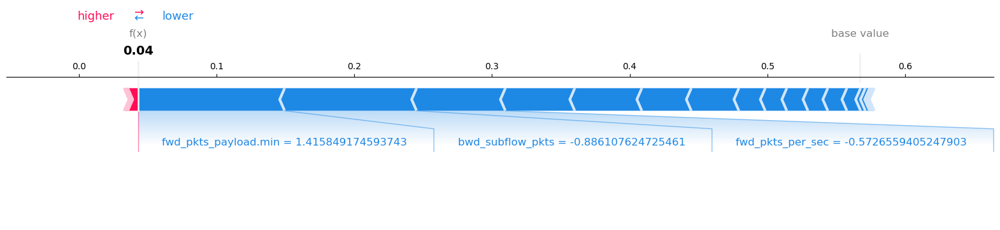

In [27]:
shap.initjs()

prediction = model.predict(X_test[start_index:end_index])[0]
print(f"The RF predicted: {prediction}")

i = 1

shap.force_plot(explainer.expected_value[i],
                      shap_values[i],
                      X_test[start_index:end_index],
                      feature_names=feature_names,
                      matplotlib=True)

#### shap.Explainer(model)

- This is a generic explainer that can be used with any type of machine learning model.
- It is model-agnostic and can handle a wide range of model types, including linear models, neural networks, and more.
- It approximates the Shapley values using a sampling approach, which might be computationally expensive for complex models or large datasets.

#### shap.TreeExplainer(model)

- This explainer is specifically designed for tree-based models, such as decision trees, random forests, and gradient boosting machines.
- It leverages the exact Shapley value computation for tree ensembles, making it computationally efficient for tree-based models.
- It provides accurate and faster Shapley values for tree models.

# *

The plot visualizes the impact of each feature on the model's output for the specified instance.

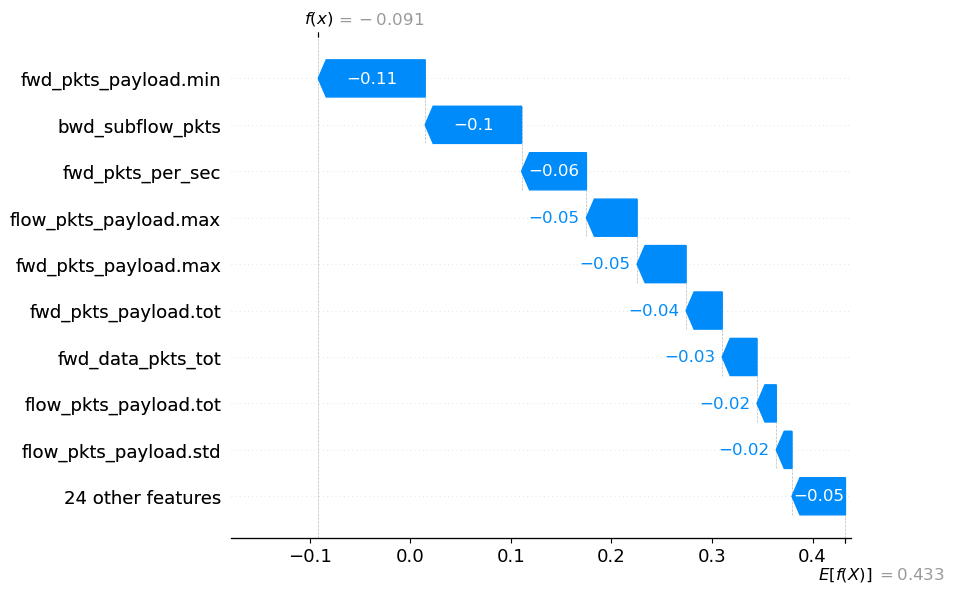

In [28]:
#explainer = shap.Explainer(model)
explainer = shap.TreeExplainer(model)

shap_values = explainer.shap_values(X_test[start_index:end_index])
base_value = explainer.expected_value

# Change shap_values[0] or shap_values[0], if you want explaination for 'Normal' or 'Malicious'
explanation = shap.Explanation(values=shap_values[1], base_values=base_value,feature_names=feature_names)

shap.plots.waterfall(explanation[0])

Explain the output of machine learning models by attributing the contribution of each feature to the model's prediction.

In [29]:
start_index = 1
end_index = 50

ex = shap.KernelExplainer(model.predict,shap.sample(X_train,100))
shap_values = explainer.shap_values(X_test[start_index:end_index])
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test[start_index:end_index],feature_names=feature_names)

# *

Gain insights into which features have the most significant impact on model predictions across the dataset.

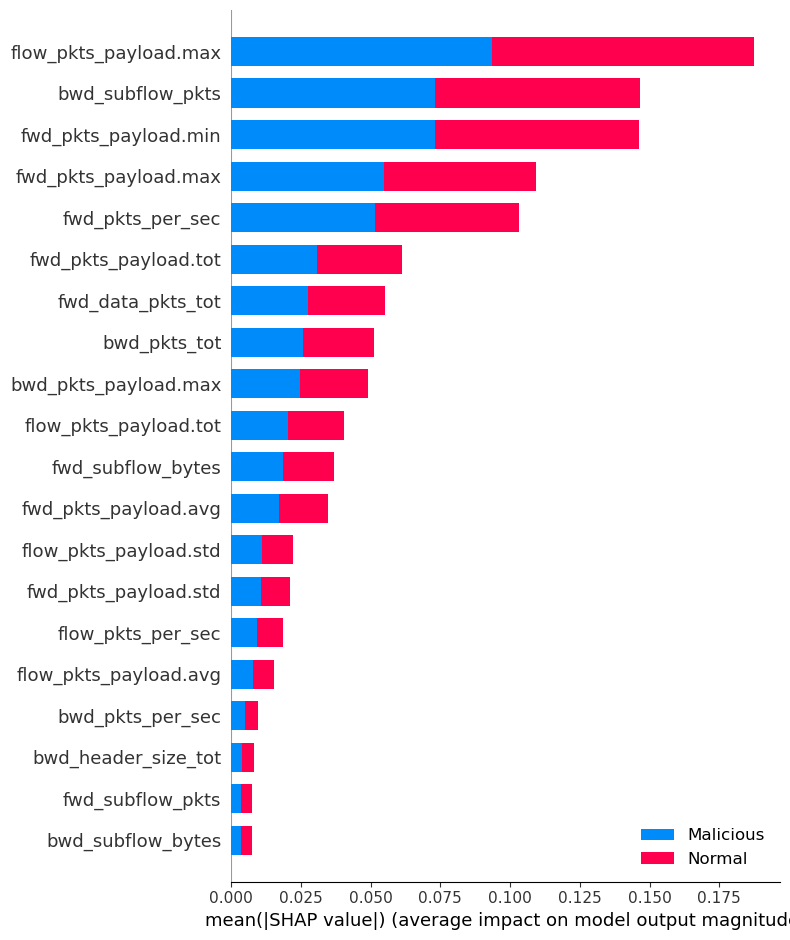

In [30]:
shap.summary_plot(shap_values, X_test,feature_names=feature_names,class_names=class_names)

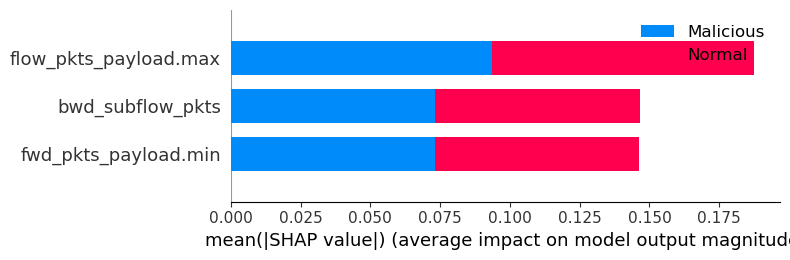

In [31]:
shap.summary_plot(shap_values, X, max_display=3,feature_names=feature_names,class_names=class_names)

Kernel SHAP explainer to compute SHAP values for a subset of instances.
Creates a summary plot to visualize the overall impact of features on model predictions for those instances.

# *

In [32]:
ex = shap.KernelExplainer(model.predict,shap.sample(X_train,100))

  0%|          | 0/49 [00:00<?, ?it/s]

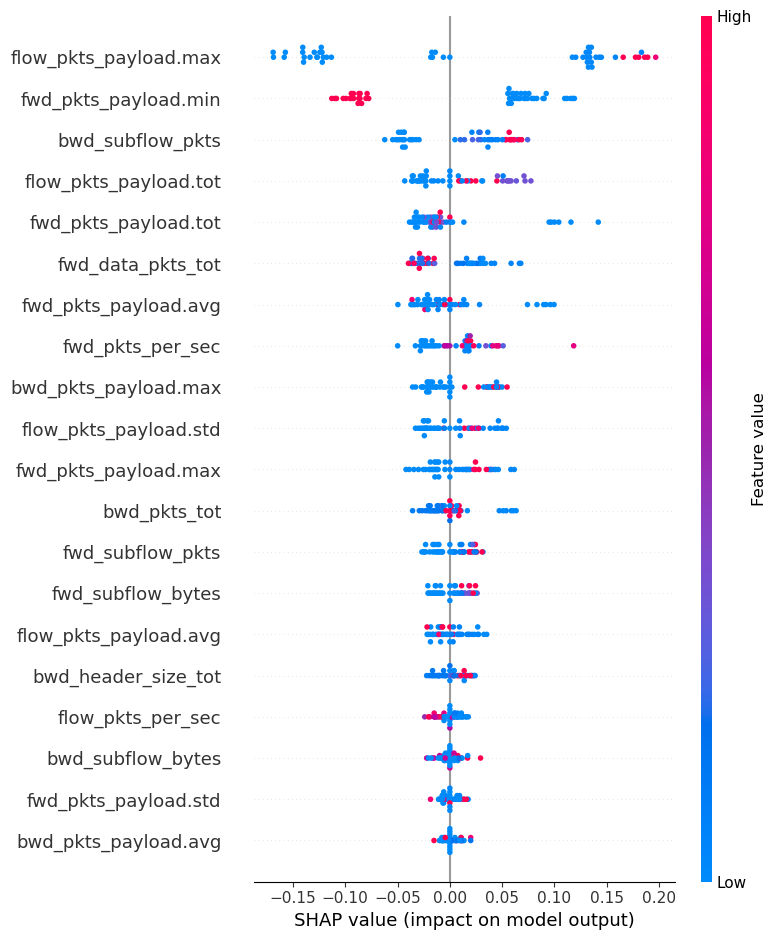

In [33]:
start_index = 1
end_index = 50

shap_values = ex.shap_values(X_test[start_index:end_index])
shap.summary_plot(shap_values, X_test[start_index:end_index],feature_names=feature_names)

In [34]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

SHAP dependence plots show the effect of a single feature across the whole dataset. They plot a feature's value vs. the SHAP value of that feature across many samples. SHAP dependence plots are similar to partial dependence plots, but account for the interaction effects present in the features, and are only defined in regions of the input space supported by data. The vertical dispersion of SHAP values at a single feature value is driven by interaction effects, and another feature is chosen for coloring to highlight possible interactions.

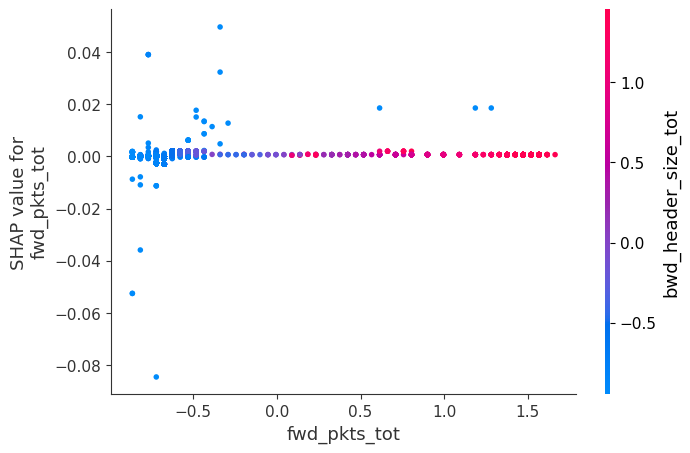

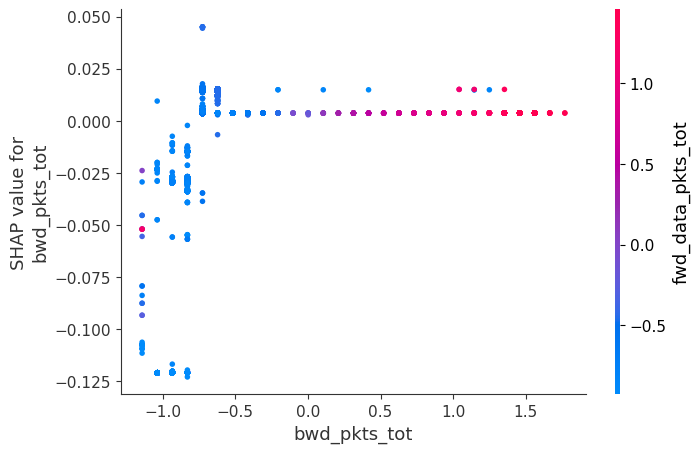

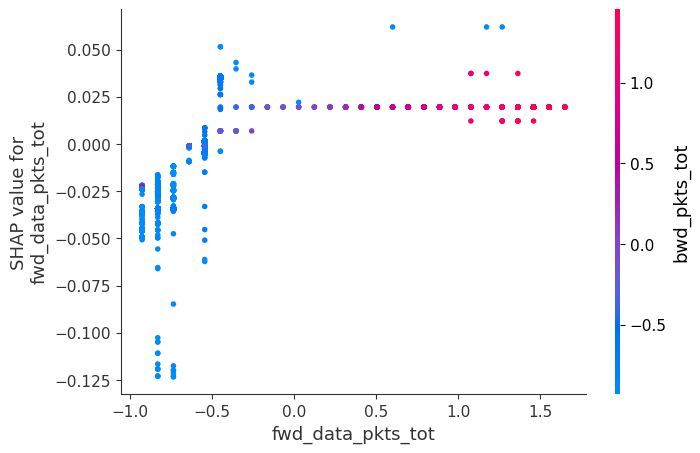

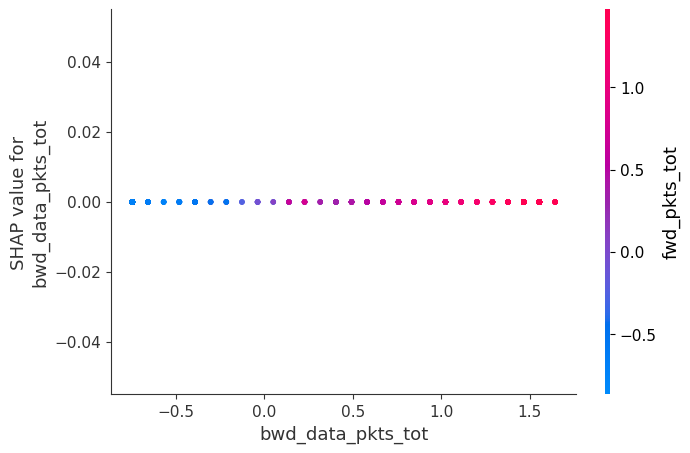

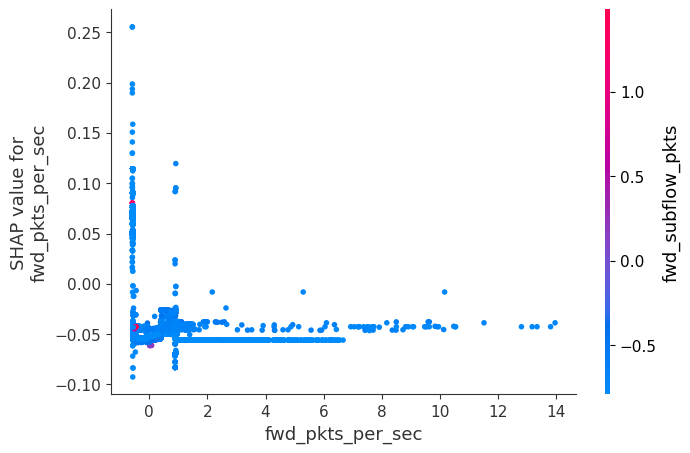

...

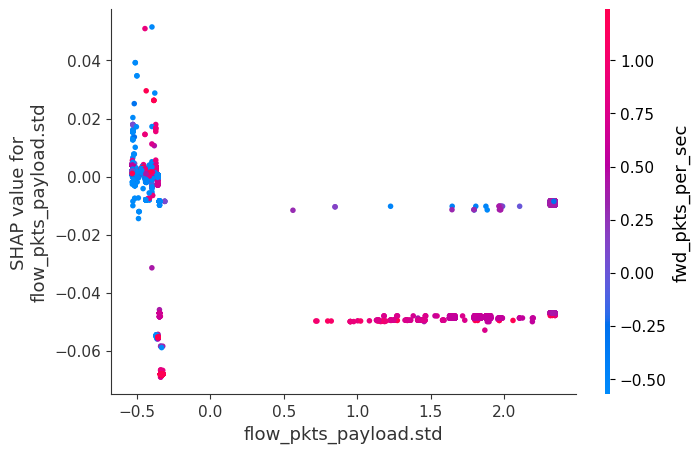

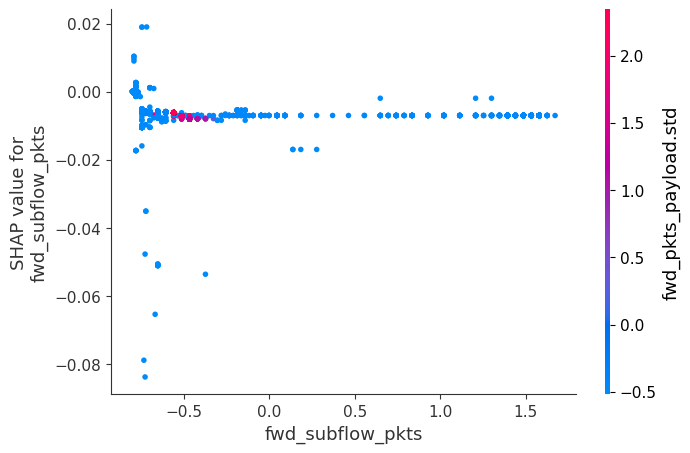

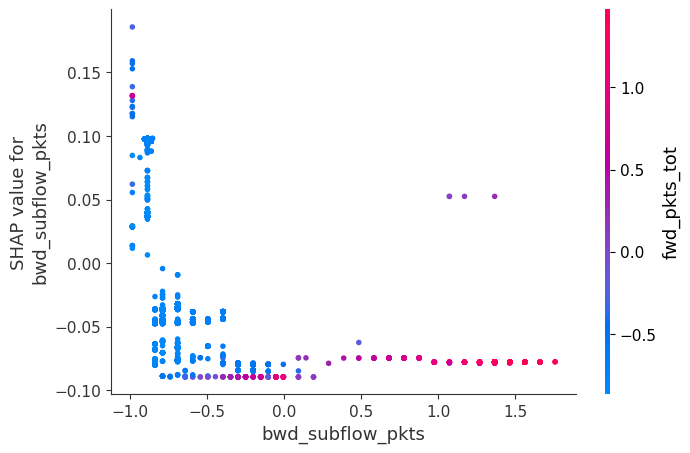

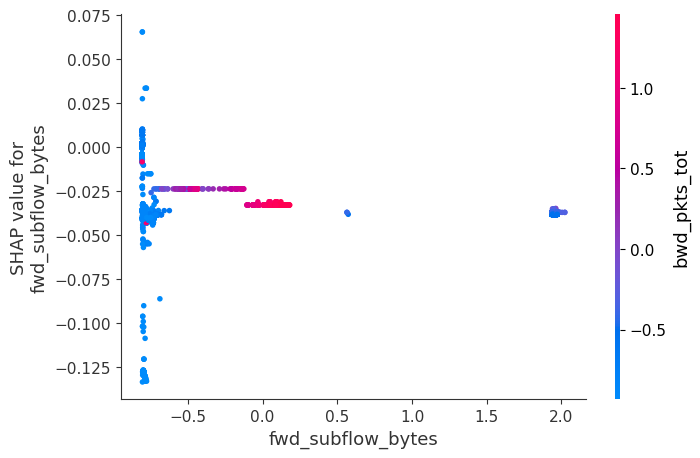

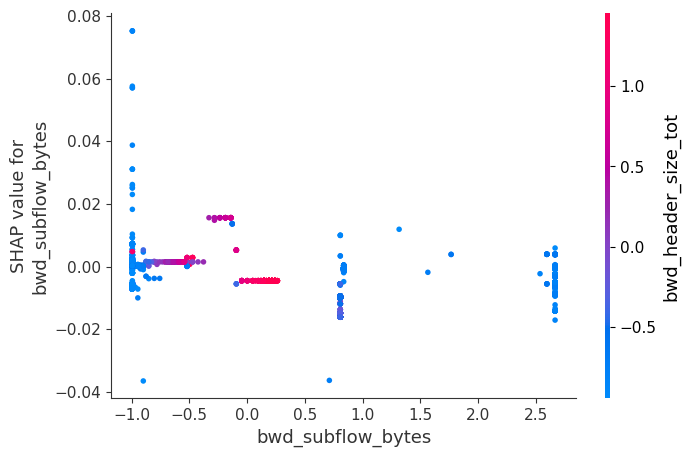

In [35]:
for i in feature_names:
    shap.dependence_plot(
        i, 
        shap_values[0], 
        X_test, 
        feature_names=feature_names)

## Shapash

### How it works
Shapash is a Python library designed to make machine learning interpretable and understandable for everyone. It provides different visualisations with clear and explicit labels that can be easily understood by anyone.

With Shapash, you can build a web application that makes it easy to understand the interactions between the features of the model and allows seamless navigation between local and global explainability.

### How does it apply
It works in a similar way to SHAP, but offers an alternative set of perspectives on the data, along with additional visualisation graphics.

### Repository:
- https://github.com/MAIF/shapash

Understanding model with shapash

In [36]:
#!pip install shapash

In [37]:
from shapash import SmartExplainer

In [38]:
xpl = SmartExplainer(model=model)
xpl.compile(x=X_test_labeled,
            y_pred=pred_series,
            y_target=y_test_target_series)

INFO: Shap explainer type - <shap.explainers._tree.TreeExplainer object at 0x000001D121A83510>


In [39]:
feature_names[25]

'flow_pkts_payload.max'

Display features importance

In [40]:
xpl.plot.features_importance()

Focus on a specific subset, and compare it with the global view

# *

In [41]:
subset = [ 168, 54, 995, 799, 310, 322, 1374,
          1106, 232, 645, 1170, 1229, 703, 66,
          886, 160, 191, 1183, 1037, 991, 482,
          725, 410, 59, 28, 719, 337, 36]

xpl.plot.features_importance(selection=subset)

Understand how a feature contributes to the classification of the model

In [42]:
xpl.plot.contribution_plot('flow_pkts_payload.max')

X has feature names, but RandomForestClassifier was fitted without feature names


Display a Summarized but Explicit local explainability

Filter method
- max_contrib : maximum number of criteria to display 
- threshold : minimum value of the contribution (in absolute value) necessary to display a criterion 
- positive : display only positive contribution? Negative?(default None) 
- features_to_hide : list of features you don’t want to display

# *

In [43]:
xpl.filter(max_contrib=8,threshold=100)

In [44]:
xpl.plot.local_plot(index=560)

Using Shapash with FastTreeSHAP explainer (Packages Not Working)

https://shapash.readthedocs.io/en/latest/tutorials/explainer_and_backend/tuto-expl05-Shapash-using-Fasttreeshap.html

Contributions comparing plot

https://shapash.readthedocs.io/en/latest/tutorials/plots_and_charts/tuto-plot04-compare_plot.html

In [45]:
from shapash.explainer.smart_explainer import SmartExplainer

In [46]:
response_dict = {0: 'Normal', 1: 'Malicious'}

In [47]:
xpl = SmartExplainer(model=model,
                     label_dict=response_dict) # Optional parameters, dicts specify labels

In [48]:
y_pred = pd.DataFrame(model.predict(X_test_labeled),columns=['pred'],index=X_test_labeled.index)

xpl.compile(
    x=X_test_labeled,
    y_pred=y_pred # Optional
)

X has feature names, but RandomForestClassifier was fitted without feature names


INFO: Shap explainer type - <shap.explainers._tree.TreeExplainer object at 0x000001D122F59310>


Compare how to index, compare to each others in terms of what feature had a bigger influence in the choice.

In [49]:
xpl.plot.compare_plot(index=[X_test_labeled.index[7], X_test_labeled.index[10]])

X has feature names, but RandomForestClassifier was fitted without feature names


In [50]:
xpl.plot.compare_plot(row_num=[0, 1, 2, 3, 4], max_features=8)

# *

In [51]:
xpl.plot.compare_plot(row_num=[8, 17], show_predict=False, max_features=100)

scatter_plot_prediction

https://shapash.readthedocs.io/en/latest/tutorials/plots_and_charts/tuto-plot06-prediction_plot.html

In [52]:
from shapash import SmartExplainer

In [53]:
response_dict = {0: 'Normal', 1: 'Malicious'}

In [54]:
xpl_classifier = SmartExplainer(model=model,label_dict=response_dict)

In [55]:
xpl_classifier.compile(x=X_test_labeled,y_target=y_test_target_series)

INFO: Shap explainer type - <shap.explainers._tree.TreeExplainer object at 0x000001D124B7D650>


Plot to visualize the ammount of FP and FN in the model predictions

In [56]:
xpl_classifier.plot.scatter_plot_prediction()

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names


## ELI5

Package installes currectly, but giving an error with imports, prob deprectated.


"ImportError: cannot import name 'if_delegate_has_method' from 'sklearn.utils.metaestimators' (C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\utils\metaestimators.py)"

### Repository:
- https://github.com/eli5-org/eli5

### Paper:
- https://arxiv.org/pdf/1907.09190.pdf

In [57]:
!pip install eli5

## Interpret ML

### How it works
- Model debugging: Uncover the causes of your model's errors to improve performance.
- Feature engineering: Extend the capabilities of your model by optimising feature selection and representation.
- Detect fairness issues: Evaluate whether your model exhibits discriminatory behaviour and address fairness concerns.
- Human-AI collaboration: Foster understanding and trust in the decision-making process by facilitating human-AI collaboration.
- Regulatory compliance: Ensure that your model meets legal requirements and complies with regulatory standards.

### How does it apply
Enables the visualisation of various XAI techniques, including LIME and SHAP, in a more intuitive and user-friendly way. To use it effectively, we strategically select a subset of training data, as larger datasets can lead to longer training times. By comparing these results with the test dataset, we gain insight into how the model makes decisions. A notable feature is the ability to examine the 'base value' or 'intercept', providing transparency into the model's biases.

### Repository:
- https://github.com/interpretml/interpret/
- https://interpret.ml/docs/blackbox.html

### Paper:
- https://arxiv.org/pdf/1909.09223.pdf

With Shapley Additive Explanations (SHAP)

In [58]:
from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())

from interpret import show
from interpret.blackbox import ShapKernel

from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline

# *

In [59]:
pca = PCA()

blackbox_model = Pipeline([('pca', pca), ('rf', model)])
blackbox_model.fit(X_train, y_train)

shap = ShapKernel(blackbox_model, X_subset_labeled,feature_names=feature_names)
#shap = ShapKernel(blackbox_model, X_train[:200],feature_names=feature_names)
shap_local = shap.explain_local(X_test[:5], y_test[:5])

show(shap_local, 0)

X has feature names, but PCA was fitted without feature names
INFO:interpret.utils._unify_data:Unifying data
X has feature names, but PCA was fitted without feature names
INFO:interpret.utils._unify_data:Unifying data


  0%|          | 0/5 [00:00<?, ?it/s]

X has feature names, but PCA was fitted without feature names
INFO:shap:num_full_subsets = 1
INFO:shap:remaining_weight_vector = array([0.17582258, 0.12112222, 0.09397414, 0.07786429, 0.06729012,
       0.0598956 , 0.054505  , 0.05046759, 0.04739565, 0.04504545,
       0.04325794, 0.04192692, 0.0409812 , 0.04037407, 0.04007721])
INFO:shap:num_paired_subset_sizes = 16
INFO:shap:weight_left = 0.7459033581807454
X has feature names, but PCA was fitted without feature names
INFO:shap:np.sum(w_aug) = 33.000000000000014
INFO:shap:np.sum(self.kernelWeights) = 1.0000000000000004
INFO:shap:phi = array([-0.00834362, -0.01767773,  0.        , -0.03575127, -0.05998519,
       -0.02750038, -0.04177512, -0.00479089, -0.00691444,  0.01801833,
       -0.03385077, -0.00977118, -0.00261603, -0.02677435, -0.0821747 ,
        0.        , -0.00920046, -0.04154125, -0.01200661, -0.00258645,
        0.        , -0.03297408, -0.01965777,  0.        , -0.01334027,
       -0.00760561, -0.0062398 , -0.00150346, 

With Local Interpretable Model-agnostic Explanations (LIME) 

**Curiosity** and needs more understanding, is how for the same row in the test dataset, SHAP values shows other features that had a greater impact in how the model choose, and in the LIME we have another set of features with different impact has the shap?

SHAP values:

- Concept: SHAP values are rooted in cooperative game theory and aim to fairly distribute the "impact" of each feature across all possible combinations of features.
- Calculation: SHAP values calculate the average contribution of each feature to the model prediction across all possible permutations of feature values.
- Consistency: SHAP scores are consistent and ensure that the sum of the scores for all features equals the difference between the model prediction and the average prediction.

LIME:

- Concept: LIME takes a different approach by generating local interpretable models around a specific instance to approximate the behaviour of the complex model in that local region.
- Computation: LIME perturbs the input data, generates a local model for each perturbed instance, and weights the influence of features based on their impact on the prediction of the local model.
- Consistency: LIME may not guarantee consistency because the explanation relies heavily on the local surrogate model.

Because SHAP and LIME use different strategies, it's expected that variations in features and their effects will be observed on the same row in the test dataset. SHAP provides a global perspective on feature importance across the dataset, considering all possible combinations of features. On the other hand, LIME provides a local, instance-specific explanation, which may result in highlighting different features and impacts for the same row.

# *

In [60]:
from interpret.blackbox import LimeTabular

In [61]:
lime = LimeTabular(blackbox_model, X_subset_labeled,feature_names=feature_names)
#lime = LimeTabular(blackbox_model, X_train[:200],feature_names=feature_names)

show(lime.explain_local(X_test[:5], y_test[:5]), 0)

INFO:interpret.utils._unify_data:Unifying data
INFO:interpret.utils._unify_data:Unifying data


With Partial Dependence Plot, allows to see the dependence that each feature has in the model impact on predicting.

In [62]:
from interpret.blackbox import PartialDependence

In [63]:
pdp = PartialDependence(blackbox_model, X_subset_labeled,feature_names=feature_names)
#pdp = PartialDependence(blackbox_model, X_train[:200],feature_names=feature_names)

show(pdp.explain_global(), 0)

X has feature names, but PCA was fitted without feature names
INFO:interpret.utils._unify_data:Unifying data
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, bu

X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has fe

X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names
X has feature names, but PCA was fitted without feature names


With Morris Sensitivity Analysis, is another way to see and understand the model feature importance

# *

In [64]:
from interpret.blackbox import MorrisSensitivity

- Mu (μ): used to represent the average or mean of a dataset.

- Mu_star (μ): Mu_star represent an adjusted or transformed mean. The difference between Mu and Mu_star indicates transformation or modification applied to the data.

- Sigma (σ): Sigma  represents the standard deviation.

- Mu_star Confidence: Level of confidence associated with the Mu_star value.

In [65]:
msa = MorrisSensitivity(blackbox_model, X_train,feature_names=feature_names)

show(msa.explain_global())

INFO:interpret.utils._unify_data:Unifying data


## OmniXAI

Installation Error: (Not Deprecated)

"  error: subprocess-exited-with-error
  
  Building wheel for hnswlib (pyproject.toml) did not run successfully.
  exit code: 1
  
  [5 lines of output]
  running bdist_wheel
  running build
  running build_ext
  building 'hnswlib' extension
  error: Microsoft Visual C++ 14.0 or greater is required. Get it with "Microsoft C++ Build Tools": https://visualstudio.microsoft.com/visual-cpp-build-tools/
  [end of output]
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for hnswlib
ERROR: Could not build wheels for hnswlib, which is required to install pyproject.toml-based projects"

### Repository:
- https://github.com/salesforce/OmniXAI/tree/main
- https://github.com/salesforce/OmniXAI/blob/main/tutorials/tabular_classification.ipynb

### Paper:
- https://arxiv.org/abs/2206.01612

In [66]:
#!pip install omnixai

## Dalex

### How it works
The DALEX package xrays any model and helps to explore and explain its behaviour, helps to understand how complex models are working. The main function explain() creates a wrapper around a predictive model. Wrapped models may then be explored and compared with a collection of local and global explainers.

### How does it apply
Helps us understand and compare other machine learning models, as well as, works as another fork of SHAP and LIME.

### Repository:
- https://github.com/ModelOriented/DALEX
- https://dalex.drwhy.ai/python-dalex-xgboost.html

### Paper:
- https://arxiv.org/abs/2012.14406

In [67]:
#!pip install dalex -U

In [68]:
import dalex as dx

In [69]:
exp = dx.Explainer(model, X_train_labeled, y_train_target_series)

Preparation of a new explainer is initiated

  -> data              : 45666 rows 33 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 45666 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x000001D121A0CB80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.4, mean = 0.899, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = -0.332, max = 0.6
  -> model_info        : package sklearn

A new explainer has been created!


X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names


In [70]:
exp.predict(X_test_labeled)

X has feature names, but RandomForestClassifier was fitted without feature names


array([1. , 1. , 0.7, ..., 1. , 1. , 1. ])

Understand the feature importance

In [71]:
exp.model_parts().plot()

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names


Understand how each feature impacted the prediction

In [72]:
exp.model_profile().plot()

Calculating ceteris paribus:   0%|          | 0/33 [00:00<?, ?it/s]X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
Calculating ceteris paribus:  21%|██        | 7/33 [00:00<00:00, 67.72it/s]X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier 

Another way of looking at LIME and understand the impact of each feature in the model prection

In [73]:
exp.predict_parts(X_test_labeled.iloc[33, :]).plot(min_max=[0,1])

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but Ran

In [74]:
pp = exp.predict_parts(X_test_labeled.iloc[[1]], type='shap_wrapper', shap_explainer_type="TreeExplainer")
type(pp)

dalex.wrappers._shap.object.ShapWrapper

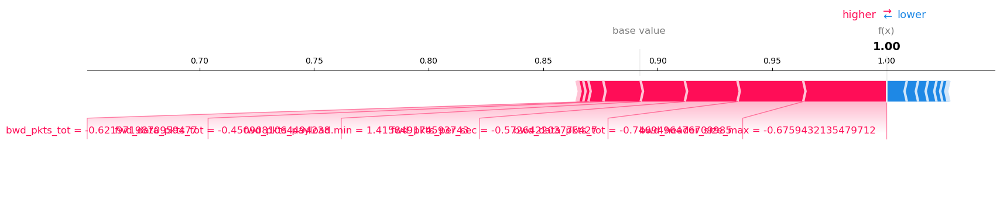

In [75]:
pp.plot()

In [76]:
mp = exp.model_parts(type='shap_wrapper', shap_explainer_type="TreeExplainer")
type(mp)

dalex.wrappers._shap.object.ShapWrapper

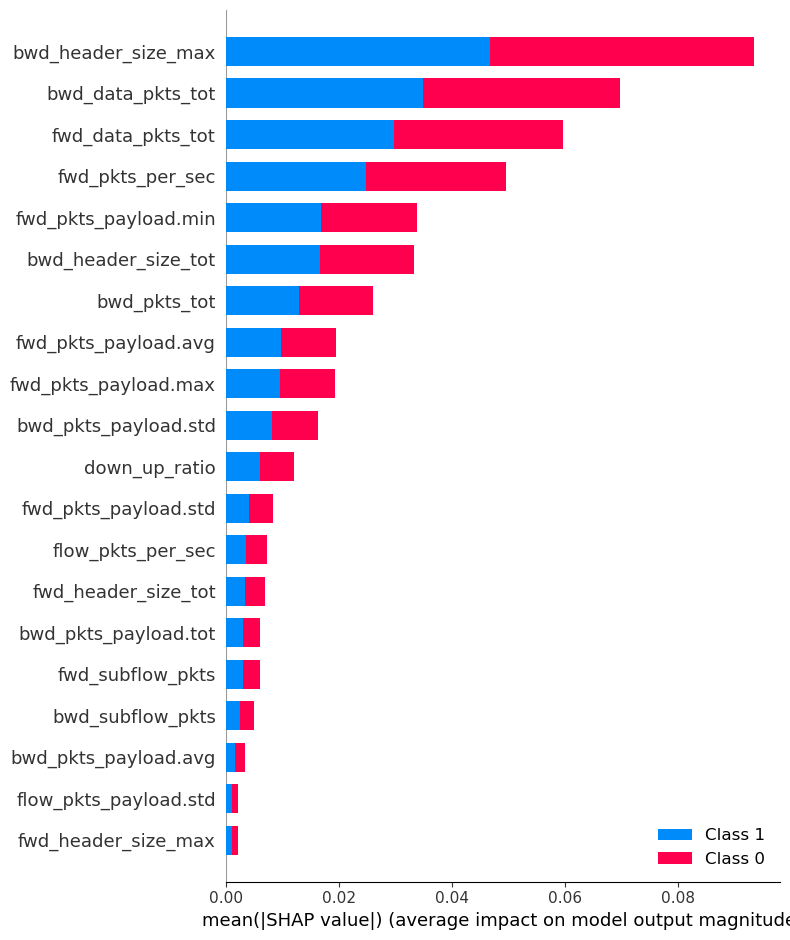

In [77]:
mp.plot()

Compare Models

In [78]:
model_filename = "IoMT_AI_IDS_MLPClassifier.joblib"
model_path = model_folder + model_filename

model_mlp = joblib.load(model_path)

Trying to unpickle estimator LabelBinarizer from version 1.3.2 when using version 1.3.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
Trying to unpickle estimator MLPClassifier from version 1.3.2 when using version 1.3.0. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations


In [79]:
exp = dx.Explainer(model, X_train, y_train)
exp_mlp = dx.Explainer(model_mlp, X_train, y_train)

Preparation of a new explainer is initiated

  -> data              : numpy.ndarray converted to pandas.DataFrame. Columns are set as string numbers.
  -> data              : 45666 rows 33 cols
  -> target variable   : 45666 values
  -> model_class       : sklearn.ensemble._forest.RandomForestClassifier (default)
  -> label             : Not specified, model's class short name will be used. (default)
  -> predict function  : <function yhat_proba_default at 0x000001D121A0CB80> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 0.4, mean = 0.899, max = 1.0
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = -1.0, mean = -0.332, max = 0.6
  -> model_info        : package sklearn

A new explainer has been created!
Preparation of a new explainer is initiated

  -> data              : numpy.ndarray converted to pand

X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but RandomForestClassifier was fitted without feature names
X has feature names, but MLPClassifier was fitted without feature names
X has feature names, but MLPClassifier was fitted without feature names


In [80]:
mp = exp.model_performance("classification")
mp_mlp = exp_mlp.model_performance("classification")

# *

In [81]:
mp.result

,recall,precision,f1,accuracy,auc
RandomForestClassifier,0.999923,0.56688,0.723558,0.566855,0.175901


In [82]:
mp_mlp

,recall,precision,f1,accuracy,auc
MLPClassifier,0.982811,0.999058,0.990867,0.98973,0.996465


In [83]:
mp.plot(mp_mlp)

Fairness module in dalex

- https://dalex.drwhy.ai/python-dalex-fairness.html (não aplicável)

## Anchor

### How it works
An anchor explanation is a rule that sufficiently “anchors” the prediction locally – such that changes to the rest of the feature values of the instance do not matter. In other words, for instances on which the anchor holds, the prediction is (almost) always the same.

### How does it apply
We can see almost like a PDF file the summary of every choice the model made to predict that value

### Repository:
- https://github.com/marcotcr/anchor

### Paper:
- https://homes.cs.washington.edu/~marcotcr/aaai18.pdf

In [84]:
#!pip install anchor-exp

In [85]:
from anchor import utils
from anchor import anchor_tabular

In [86]:
explainer = anchor_tabular.AnchorTabularExplainer(
    class_names,
    feature_names,
    X_train)

In [87]:
idx = 3
np.random.seed(1)
print('Prediction: ', explainer.class_names[model.predict(X_test[idx].reshape(1, -1))[0]])
exp = explainer.explain_instance(X_test[idx], model.predict, threshold=0.95)

Prediction:  Malicious


In [88]:
print('Anchor: %s' % (' AND '.join(exp.names())))
print('Precision: %.2f' % exp.precision())
print('Coverage: %.2f' % exp.coverage())

Anchor: 
Precision: 1.00
Coverage: 1.00


In [89]:
# Get test examples where the anchora pplies
fit_anchor = np.where(np.all(X_test[:, exp.features()] == X_test[idx][exp.features()], axis=1))[0]
print('Anchor test precision: %.2f' % (np.mean(model.predict(X_test[fit_anchor]) == model.predict(X_test[idx].reshape(1, -1)))))
print('Anchor test coverage: %.2f' % (fit_anchor.shape[0] / float(X_test.shape[0])))

Anchor test precision: 1.00
Anchor test coverage: 1.00


In [90]:
print('Partial anchor: %s' % (' AND '.join(exp.names(1))))
print('Partial precision: %.2f' % exp.precision(1))
print('Partial coverage: %.2f' % exp.coverage(1))

Partial anchor: 
Partial precision: 1.00
Partial coverage: 1.00


In [91]:
fit_partial = np.where(np.all(X_test[:, exp.features(1)] == X_test[idx][exp.features(1)], axis=1))[0]
print('Partial anchor test precision: %.2f' % (np.mean(model.predict(X_test[fit_partial]) == model.predict(X_test[idx].reshape(1, -1)))))
print('Partial anchor test coverage: %.2f' % (fit_partial.shape[0] / float(X_test.shape[0])))

Partial anchor test precision: 1.00
Partial anchor test coverage: 1.00


# *

In [92]:
exp.show_in_notebook()

## XAI - eXplainability AI

### Error 
on install due to python version, python needs to be on version 3.7

### Repository:
- https://github.com/EthicalML/xai

In [93]:
import sys
print(sys.version)

3.11.5 | packaged by Anaconda, Inc. | (main, Sep 11 2023, 13:26:23) [MSC v.1916 64 bit (AMD64)]


## AIX360

### How it works
The AI Explainability 360 toolkit is an open-source library that supports interpretability and explainability of datasets and machine learning models. The AI Explainability 360 Python package includes a comprehensive set of algorithms that cover different dimensions of explanations along with proxy explainability metrics. The AI Explainability 360 toolkit supports tabular, text, images, and time series data.

### How does it apply


### Repository:
- https://github.com/Trusted-AI/AIX360

### Paper:
- https://arxiv.org/abs/1909.03012

In [94]:
#!pip install aix360

R2 Score (Coefficient of Determination):
- R2 score measures the proportion of the variance in the dependent variable (target) that is predictable from the independent variables (features).
- The value ranges from 0 to 1, with 1 indicating a perfect prediction. A higher R2 score signifies a better-fitting model.

Explained Variance Score:
- Explained Variance Score measures the proportion of the variance in the dependent variable that the model explains.
- Like R2 score, it ranges from 0 to 1, with 1 being the best.

Mean Absolute Error (MAE):
- MAE represents the average absolute difference between the predicted and actual values.
- It gives an idea of the average magnitude of the errors in the predictions.

Max Error:
- Max Error represents the largest absolute error between the predicted and actual values.
- It identifies the worst-case scenario in terms of prediction error.

In [95]:
from sklearn.metrics import r2_score, explained_variance_score, mean_absolute_error, max_error

print(f'R2 Score = {r2_score(y_test, pred)}')
print(f'Explained Variance = {explained_variance_score(y_test, pred)}')
print(f'Mean abs. error = {mean_absolute_error(y_test, pred)}')
print(f'Max error = {max_error(y_test, pred)}')

R2 Score = 0.9571897114054795
Explained Variance = 0.9575244568134392
Mean abs. error = 0.01051110235185915
Max error = 1


Most of the Explanation are for Time duration, or pre-processing understanding

## What if Tool

### How it works
The What-If Tool (WIT) provides an easy-to-use interface for expanding understanding of a black-box classification or regression ML model. Can perform inference on a large set of examples and immediately visualize the results in a variety of ways. Additionally, examples can be edited manually or programmatically and re-run through the model in order to see the results of the changes. It contains tooling for investigating model performance and fairness over subsets of a dataset.

### Disclaimer
Web Plataform to understand ML Models with minimal coding, must use TF Models, we use skt-learn

### Repository:
- https://github.com/PAIR-code/what-if-tool?tab=readme-ov-file
- https://colab.research.google.com/github/pair-code/what-if-tool/blob/master/What_If_Tool_Notebook_Usage.ipynb#scrollTo=YyLr-_0de1Ii

### Paper:
- https://arxiv.org/abs/1907.04135

## Skater (Oracle)

### How it works
Fork, since the original got deleted.
Skater is a unified framework to enable Model Interpretation for all forms of model to help one build an Interpretable machine learning system often needed for real world use-cases. It is an open source python library designed to demystify the learned structures of a black box model both globally and locally.

### Installation Error
Deprecated Package

"`numpy.distutils` is deprecated since NumPy 1.23.0, as a result
    of the deprecation of `distutils` itself. It will be removed for
    Python >= 3.12. For older Python versions it will remain present.
    It is recommended to use `setuptools < 60.0` for those Python versions.
    For more details, see:
      https://numpy.org/devdocs/reference/distutils_status_migration.html"


### Repository:
- https://github.com/GapData/skater

In [96]:
#!pip install -U skater

## Alibi

### How it works
Alibi is an Python library aimed at machine learning model inspection and interpretation. The focus of the library is to provide high-quality implementations of black-box, white-box, local and global explanation methods for classification and regression models.

### How does it apply
Makes use of "RandomForestClassifier"


### Repository:
- https://github.com/SeldonIO/alibi

### Paper:
- https://www.jmlr.org/papers/volume22/21-0017/21-0017.pdf

In [97]:
#!pip install alibi

Archors

Initialize and fit anchor explainer for tabular data

Getting an anchor

We get an anchor for the prediction of the first observation in the test set. An anchor is a sufficient condition - that is, when the anchor holds, the prediction should be the same as the prediction for this instance.

We set the precision threshold to 0.95. This means that predictions on observations where the anchor holds will be the same as the prediction on the explained instance at least 95% of the time.

Getting this error: IndexError: too many indices for array: array is 2-dimensional, but 3 were indexed

Kernel SHAP explanation

In [98]:
import shap
shap.initjs()

from alibi.explainers import KernelShap

Partial Dependence and Individual Conditional Expectation
- Partial dependence (PD) and the individual conditional expectation (ICE) to determine the feature effects on the model.

In [99]:
from alibi.explainers import PartialDependence, plot_pd

In [100]:
prediction_fn = lambda x: model.predict(X_train)

In [101]:
explainer = PartialDependence(predictor=prediction_fn,
                              feature_names=feature_names,
                              target_names=class_names)

In [102]:
feature_names

['fwd_pkts_tot',
 'bwd_pkts_tot',
 'fwd_data_pkts_tot',
 'bwd_data_pkts_tot',
 'fwd_pkts_per_sec',
 'bwd_pkts_per_sec',
 'flow_pkts_per_sec',
 'down_up_ratio',
 'fwd_header_size_tot',
 'fwd_header_size_min',
 'fwd_header_size_max',
 'bwd_header_size_tot',
 'bwd_header_size_min',
 'bwd_header_size_max',
 'fwd_pkts_payload.min',
 'fwd_pkts_payload.max',
 'fwd_pkts_payload.tot',
 'fwd_pkts_payload.avg',
 'fwd_pkts_payload.std',
 'bwd_pkts_payload.min',
 'bwd_pkts_payload.max',
 'bwd_pkts_payload.tot',
 'bwd_pkts_payload.avg',
 'bwd_pkts_payload.std',
 'flow_pkts_payload.min',
 'flow_pkts_payload.max',
 'flow_pkts_payload.tot',
 'flow_pkts_payload.avg',
 'flow_pkts_payload.std',
 'fwd_subflow_pkts',
 'bwd_subflow_pkts',
 'fwd_subflow_bytes',
 'bwd_subflow_bytes']

In [103]:
features = [feature_names.index('fwd_pkts_payload.max'),
            feature_names.index('fwd_pkts_payload.min'),
            feature_names.index('bwd_pkts_payload.max'),
            feature_names.index('bwd_pkts_payload.min')]

In [104]:
exp = explainer.explain(X=X_train,
                        features=features,
                        kind='average')

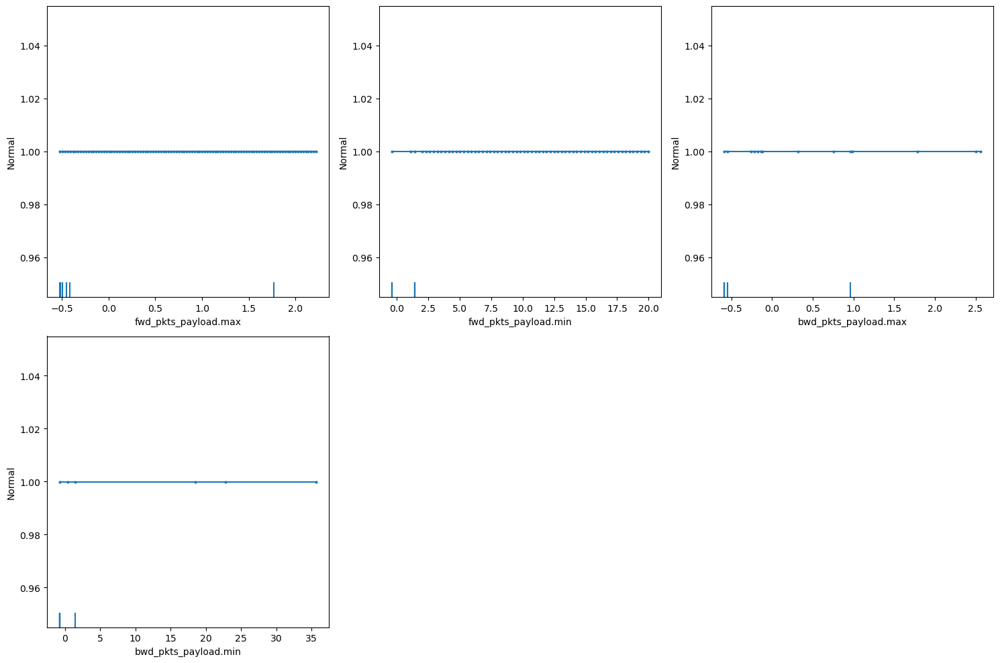

In [105]:
# random seed for `ice` sampling
np.random.seed(13)

# plot the pd and ice
plot_pd(exp=exp,
        n_cols=3,
        n_ice=50,   # number of ICE curves to be displayed. Can be set to 'all' or provided a list of indices
        sharey='row',
        center=True,  # center the plots for better visualization
        fig_kw={'figheight': 10, 'figwidth': 15});

Permutation Feature Importance
- Uses RandomForestClassifier instead of RandomForest

Explaining Tree Models with Interventional Feature Perturbation Tree SHAP

In [106]:
from alibi.explainers import KernelShap, TreeShap
from functools import partial
from itertools import zip_longest

import shap
shap.initjs()

In [107]:
tree_explainer_interventional = TreeShap(model, model_output='raw', task='classification')
tree_explainer_interventional.fit(background_data=X_subset_labeled)

explanation = tree_explainer_interventional.explain(X_test_labeled, check_additivity=False)


# *

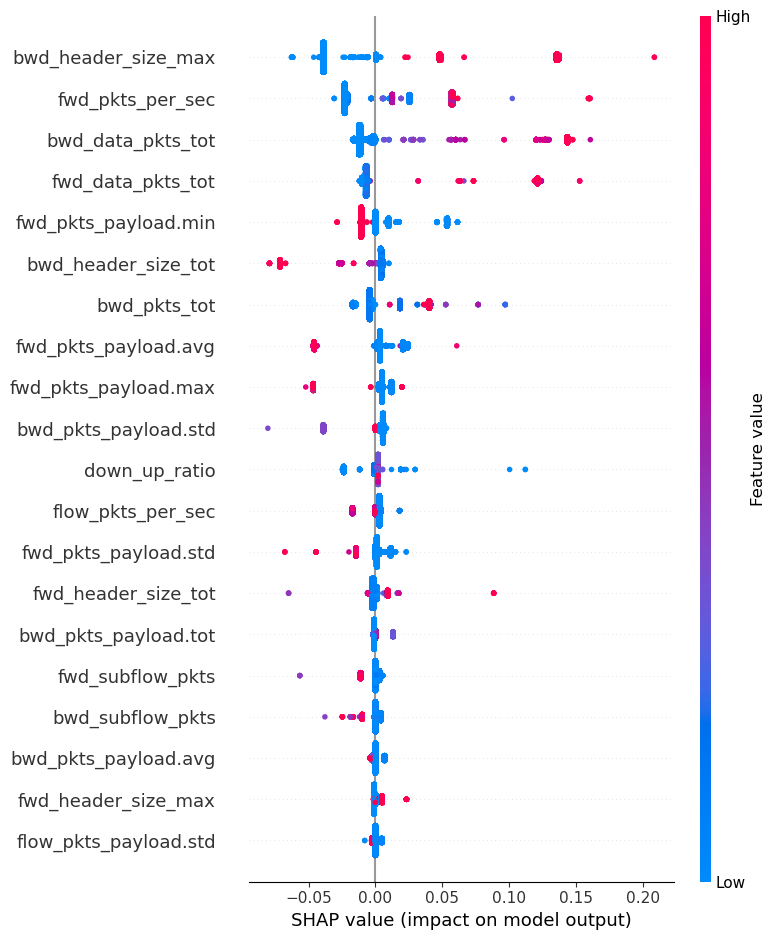

In [108]:
shap.summary_plot(explanation.shap_values[0], X_test, feature_names)

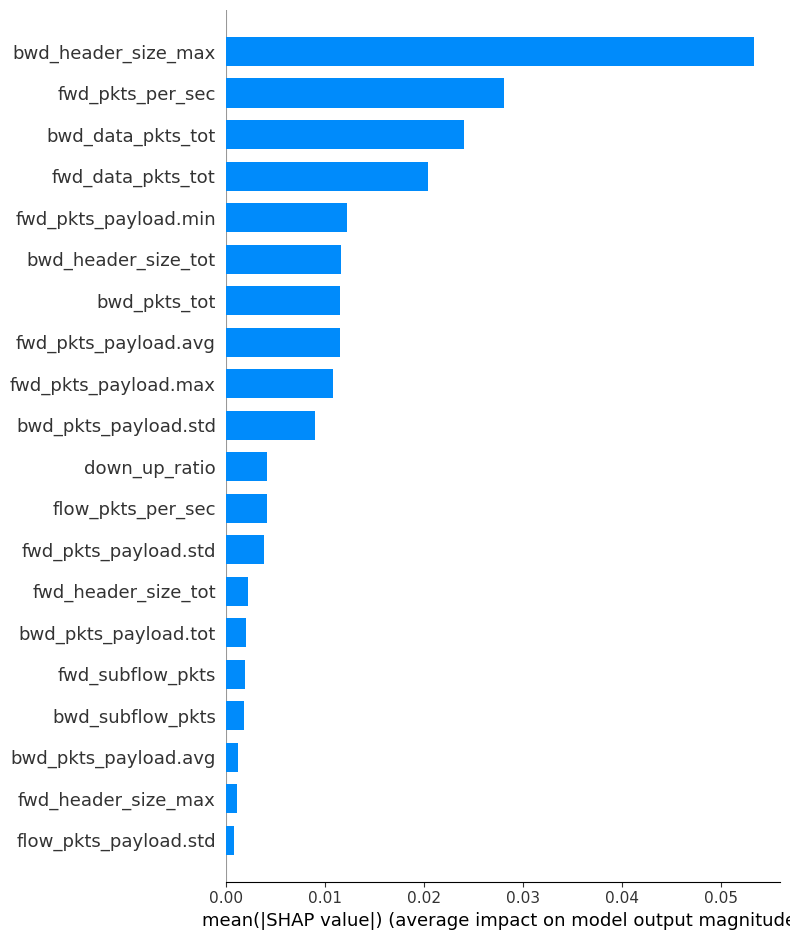

In [109]:
shap.summary_plot(explanation.shap_values[0], X_test, feature_names, plot_type='bar')

In [110]:
def _dependence_plot(features, shap_values, dataset, feature_names, category_map, display_features=None, **kwargs):
    """
    Plots dependence plots of specified features in a grid.

    features: List[str], List[Tuple[str, str]]
        Names of features to be plotted. If List[str], then shap
        values are plotted as a function of feature value, coloured
        by the value of the feature determined to have the strongest
        interaction (empirically). If List[Tuple[str, str]], shap
        interaction values are plotted.
    display_features: np.ndarray, N x F
        Same as dataset, but contains human readable values
        for categorical levels as opposed to numerical values
    """

    def _set_fonts(fig, ax, fonts=None, set_cbar=False):
        """
        Sets fonts for axis labels and colobar.
        """

        ax.xaxis.label.set_size(xlabelfontsize)
        ax.yaxis.label.set_size(ylabelfontsize)
        ax.tick_params(axis='x', labelsize=xtickfontsize)
        ax.tick_params(axis='y', labelsize=ytickfontsize)
        if set_cbar:
            fig.axes[-1].tick_params(labelsize=cbartickfontsize)
            fig.axes[-1].tick_params(labelrotation=cbartickrotation)
            fig.axes[-1].yaxis.label.set_size(cbarlabelfontsize)

    # parse plotting args
    figsize = kwargs.get("figsize", (15, 10))
    nrows = kwargs.get('nrows', len(features))
    ncols = kwargs.get('ncols', 1)
    xlabelfontsize = kwargs.get('xlabelfontsize', 14)
    xtickfontsize = kwargs.get('xtickfontsize', 11)
    ylabelfontsize = kwargs.get('ylabelfontsize', 14)
    ytickfontsize = kwargs.get('ytickfontsize', 11)
    cbartickfontsize = kwargs.get('cbartickfontsize', 14)
    cbartickrotation = kwargs.get('cbartickrotation', 10)
    cbarlabelfontsize = kwargs.get('cbarlabelfontsize', 14)
    rotation_orig = kwargs.get('xticklabelrotation', 25)

    alpha = kwargs.get("alpha", 1)
    x_jitter_orig = kwargs.get("x_jitter", 0.8)
    grouped_features = list(zip_longest(*[iter(features)] * ncols))


    fig, axes = plt.subplots(nrows, ncols,  figsize=figsize)
    if nrows == len(features):
        axes = list(zip_longest(*[iter(axes)] * 1))


    for i, (row, group) in enumerate(zip(axes, grouped_features), start=1):
        # plot each feature or interaction in a subplot
        for ax, feature in zip(row, group):
            # set x-axis ticks and labels and x-jitter for categorical variables
            if not feature:
                continue
            if isinstance(feature, list) or isinstance(feature, tuple):
                feature_index = feature_names.index(feature[0])
            else:
                feature_index = feature_names.index(feature)
            if feature_index in category_map:
                ax.set_xticks(np.arange(len(category_map[feature_index])))
                if i == nrows:
                    rotation = 90
                else:
                    rotation = rotation_orig
                ax.set_xticklabels(category_map[feature_index], rotation=rotation, fontsize=22)
                x_jitter = x_jitter_orig
            else:
                x_jitter = 0

            shap.dependence_plot(feature,
                                 shap_values,
                                 dataset,
                                 feature_names=feature_names,
                                 display_features=display_features,
                                 interaction_index='auto',
                                 ax=ax,
                                 show=False,
                                 x_jitter=x_jitter,
                                 alpha=alpha
                                )
            if i!= nrows:
                ax.tick_params('x', labelrotation=rotation_orig)
            _set_fonts(fig, ax, set_cbar=True)

plot_dependence = partial(
    _dependence_plot,
    feature_names=feature_names,
    category_map=[],
)

## AIF360

### How it works
The AI Fairness 360 toolkit is an extensible open-source library containing techniques developed by the research community to help detect and mitigate bias in machine learning models throughout the AI application lifecycle. AI Fairness 360 package is available in both Python and R.

The AI Fairness 360 package includes:

- a comprehensive set of metrics for datasets and models to test for biases,
- explanations for these metrics, and
- algorithms to mitigate bias in datasets and models. It is designed to translate algorithmic research from the lab into the actual practice of domains as wide-ranging as finance, human capital management, healthcare, and education. We invite you to use it and improve it.

### How does it apply
AIF360 library used for fairness accessment and privileged and unprivileged groups


### Repository:
- https://github.com/Trusted-AI/AIF360

### Paper:
- https://arxiv.org/abs/1810.01943

In [111]:
#!pip install aif360

## LIT

### How it works
The Learning Interpretability Tool (🔥LIT, formerly known as the Language Interpretability Tool) is a visual, interactive ML model-understanding tool that supports text, image, and tabular data. It can be run as a standalone server, or inside of notebook environments such as Colab, Jupyter, and Google Cloud Vertex AI notebooks.

### Installation Error
`numpy.distutils` is deprecated since NumPy 1.23.0, as a result
    of the deprecation of `distutils` itself. It will be removed for
    Python >= 3.12. For older Python versions it will remain present.
    It is recommended to use `setuptools < 60.0` for those Python versions.
    For more details, see:
      https://numpy.org/devdocs/reference/distutils_status_migration.html
  

### Repository:
- https://github.com/PAIR-code/lit

### Paper:
- https://arxiv.org/abs/2008.05122

In [112]:
#!pip install lit-nlp

## WeightWatcher

### How it works
WeightWatcher (WW) is an open-source, diagnostic tool for analyzing Deep Neural Networks (DNN), without needing access to training or even test data. It is based on theoretical research into Why Deep Learning Works, based on our Theory of Heavy-Tailed Self-Regularization (HT-SR). It uses ideas from Random Matrix Theory (RMT), Statistical Mechanics, and Strongly Correlated Systems.

### Disclaimer
Only for web models or pythorch models

### Repository:
- https://github.com/PAIR-code/lit

### Paper:
- https://arxiv.org/abs/2008.05122

In [113]:
#!pip install weightwatcher

## Black Box Auditing

### Disclaimer
Bias identification

### Repository:
- https://github.com/algofairness/BlackBoxAuditing

### Paper:
- https://arxiv.org/abs/1412.3756

In [114]:
#!pip install BlackBoxAuditing

## Interpretable ML

### How it works
Modern machine-learning models are increasingly complex, often making them difficult to interpret. This package provides a simple interface for fitting and using state-of-the-art interpretable models, all compatible with scikit-learn. These models can often replace black-box models (e.g. random forests) with simpler models (e.g. rule lists) while improving interpretability and computational efficiency, all without sacrificing predictive accuracy! Simply import a classifier or regressor and use the fit and predict methods, same as standard scikit-learn models.

### How it applys
Library to compare models

### Repository:
- https://github.com/csinva/imodels

### Paper:
- https://joss.theoj.org/papers/10.21105/joss.03192

In [115]:
#!pip install imodels

In [116]:
from imodels import HSTreeClassifierCV

In [117]:
immodel = HSTreeClassifierCV(max_leaf_nodes=4)  # initialize a tree model and specify only 4 leaf nodes
immodel.fit(X_train, y_train, feature_names=feature_names)   # fit model
preds = immodel.predict(X_test) # discrete predictions: shape is (n_test, 1)
preds_proba = model.predict_proba(X_test) # predicted probabilities: shape is (n_test, n_classes)

In [118]:
print(immodel) # print the model

> ------------------------------
> Decision Tree with Hierarchical Shrinkage
> 	Prediction is made by looking at the value in the appropriate leaf of the tree
> ------------------------------
|--- feature_14 <= 1.27
|   |--- feature_30 <= -0.96
|   |   |--- weights: [0.41, 0.59] class: 1.0
|   |--- feature_30 >  -0.96
|   |   |--- weights: [0.00, 1.00] class: 1.0
|--- feature_14 >  1.27
|   |--- feature_27 <= -0.56
|   |   |--- weights: [0.98, 0.02] class: 0.0
|   |--- feature_27 >  -0.56
|   |   |--- weights: [0.03, 0.97] class: 1.0



Error Detection

In [119]:
import imodels
from sklearn.ensemble import RandomForestClassifier

In [120]:
model, feature_names = imodels.explain_classification_errors(X_test, model.predict(X_test), y_test,
                                                             feature_names=feature_names,
                                                             classifier=RandomForestClassifier(max_depth=3))

RandomForestClassifier(max_depth=3)


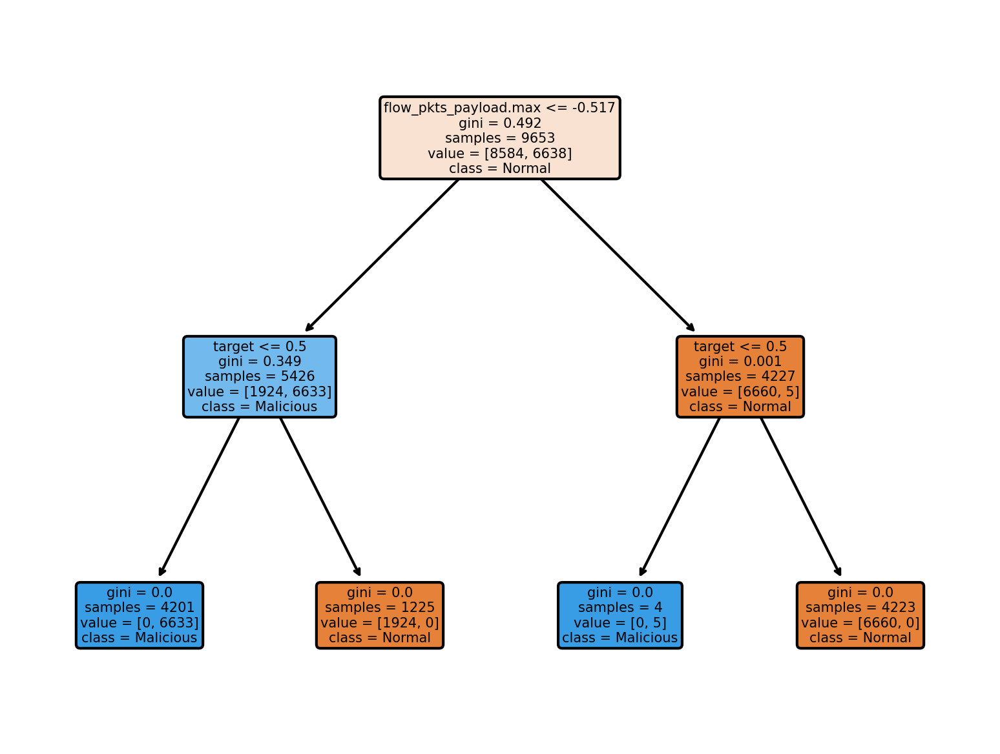

In [121]:
from sklearn.tree import plot_tree

tree_to_plot = model.estimators_[0]

# Convert the Pandas Index to a list
feature_names_list = feature_names.tolist()

plt.figure(dpi=300)
plot_tree(tree_to_plot, feature_names=feature_names_list, filled=True, rounded=True, class_names=class_names)
plt.show()

Figs Classifier

In [122]:
from imodels import FIGSClassifier

In [123]:
model_figs = FIGSClassifier(max_rules=7, max_trees=3)

In [124]:
print(len(feature_names))
print(X_train.shape[1])

34
33


In [125]:
model_figs.fit(X_train, y_train, feature_names=feature_names.drop('target'))

FIGSClassifier(max_rules=7, max_trees=3)

In [126]:
print(model_figs)

> ------------------------------
> FIGS-Fast Interpretable Greedy-Tree Sums:
> 	Predictions are made by summing the "Val" reached by traversing each tree.
> 	For classifiers, a sigmoid function is then applied to the sum.
> ------------------------------
fwd_pkts_payload.min <= 1.266 (Tree #0 root)
	bwd_pkts_payload.min <= 9.990 (split)
		Val: 0.998 (leaf)
		Val: 0.249 (leaf)
	fwd_pkts_payload.max <= -0.517 (split)
		Val: 0.019 (leaf)
		Val: 0.966 (leaf)

	+
bwd_pkts_per_sec <= -0.475 (Tree #1 root)
	fwd_data_pkts_tot <= -0.690 (split)
		Val: -0.122 (leaf)
		flow_pkts_per_sec <= -0.536 (split)
			fwd_subflow_bytes <= -0.805 (split)
				Val: -0.348 (leaf)
				Val: -0.998 (leaf)
			Val: -0.998 (leaf)
	Val: 0.001 (leaf)



In [127]:
print(model_figs.print_tree(X_train, y_train))

------------
fwd_pkts_payload.min <= 1.266 25888/45666 (56.69%)
	bwd_pkts_payload.min <= 9.990 25112/25171 (99.77%)
		ΔRisk = 1.00 25111/25167 (99.78%)
		ΔRisk = 0.25 1/4 (25.0%)
	fwd_pkts_payload.max <= -0.517 776/20495 (3.79%)
		ΔRisk = 0.02 376/20081 (1.87%)
		ΔRisk = 0.97 400/414 (96.62%)

	+
bwd_pkts_per_sec <= -0.475 25888/45666 (56.69%)
	fwd_data_pkts_tot <= -0.690 101/148 (68.24%)
		ΔRisk = -0.12 88/104 (84.62%)
		flow_pkts_per_sec <= -0.536 13/44 (29.55%)
			fwd_subflow_bytes <= -0.805 13/29 (44.83%)
				ΔRisk = -0.35 13/20 (65.0%)
				ΔRisk = -1.00 0/9 (0.0%)
			ΔRisk = -1.00 0/15 (0.0%)
	ΔRisk = 0.00 25787/45518 (56.65%)



Gini Importance

In [128]:
dfp_importance = pd.DataFrame({'feat_names': feature_names})
dfp_importance['feature'] = dfp_importance.index
dfp_importance_gini = pd.DataFrame({'importance_gini': model_figs.feature_importances_})
dfp_importance_gini['feature'] = dfp_importance_gini.index
dfp_importance_gini['importance_gini_pct'] = dfp_importance_gini['importance_gini'].rank(pct=True)
dfp_importance = pd.merge(dfp_importance, dfp_importance_gini, on='feature', how='left')
dfp_importance = dfp_importance.sort_values(by=['importance_gini', 'feature'], ascending=[False, True]).reset_index(drop=True)
display(dfp_importance)

,feat_names,feature,importance_gini,importance_gini_pct
0,fwd_pkts_payload.min,14,0.960126,1.000000
1,fwd_pkts_payload.max,15,0.033717,0.969697
2,bwd_pkts_per_sec,5,0.002777,0.939394
3,fwd_data_pkts_tot,2,0.001905,0.909091
4,bwd_pkts_payload.min,19,0.000631,0.878788
5,fwd_subflow_bytes,31,0.000481,0.848485
6,flow_pkts_per_sec,6,0.000364,0.818182
7,fwd_pkts_tot,0,0.000000,0.409091
8,bwd_pkts_tot,1,0.000000,0.409091
9,bwd_data_pkts_tot,3,0.000000,0.409091


dtreeviz Integration

In [129]:
#!pip install dtreeviz

In [130]:
import dtreeviz
from imodels.tree.viz_utils import extract_sklearn_tree_from_figs

Incompatibility in the dtype (data type) of the node array when trying to set the state of a tree object. 

In [131]:
#dt = extract_sklearn_tree_from_figs(model_figs, tree_num=0, n_classes=2)
#viz_model = dtreeviz.model(dt_train, X_train=X_train, y_train=y_train, feature_names=feature_names, target_name='y', class_names=[0, 1])

Compare Models

In [132]:
m = imodels.AutoInterpretableClassifier()
m.fit(X_subset, y_subset, cv=3)

print("best params", m.est_.best_params_)
print("best score", m.est_.best_score_)
print("best estimator", m.est_.best_estimator_)
print("best estimator params", m.est_.best_estimator_.get_params())

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafon

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafon

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafon

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafon

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafon

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coe

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\svm\_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
C:\Users\ivoafon

best params {'est': RuleFitClassifier(max_rules=100, n_estimators=20), 'est__max_rules': 100, 'est__n_estimators': 20}
best score 0.9963688279543472
best estimator Pipeline(steps=[('est', RuleFitClassifier(max_rules=100, n_estimators=20))])
best estimator params {'memory': None, 'steps': [('est', RuleFitClassifier(max_rules=100, n_estimators=20))], 'verbose': False, 'est': RuleFitClassifier(max_rules=100, n_estimators=20), 'est__alpha': None, 'est__cv': True, 'est__exp_rand_tree_size': True, 'est__include_linear': True, 'est__lin_standardise': True, 'est__lin_trim_quantile': 0.025, 'est__max_rules': 100, 'est__memory_par': 0.01, 'est__n_estimators': 20, 'est__random_state': None, 'est__sample_fract': 'default', 'est__tree_generator': None, 'est__tree_size': 4}


In [133]:
df = pd.DataFrame(m.est_.cv_results_).sort_values("rank_test_score")
first_cols = ["rank_test_score", "mean_test_score", "std_test_score"]
df = df[first_cols + [c for c in df.columns if c not in first_cols]].round(3)
# remove std_ cols
df = df[[c for c in df.columns if "std_" not in c]]
df

,rank_test_score,mean_test_score,mean_fit_time,mean_score_time,param_est,param_est__max_leaf_nodes,param_est__max_rules,param_est__n_estimators,param_est__n_boosting_rounds,param_est__C,param_est__l1_ratio,param_est__alpha,params,split0_test_score,split1_test_score,split2_test_score
4,1,0.996,31.431,0.088,RuleFitClassifier(max_rules=100),NaN,100,20,NaN,NaN,NaN,NaN,"{'est': RuleFitClassifier(max_rules=100), 'est...",0.996,0.996,0.998
6,2,0.996,4.137,0.174,TreeGAMClassifier(),NaN,NaN,NaN,100,NaN,NaN,NaN,"{'est': TreeGAMClassifier(), 'est__n_boosting_...",0.996,0.996,0.997
8,3,0.995,0.013,0.002,HSTreeClassifier(est=DecisionTreeClassifier(ma...,10,NaN,NaN,NaN,NaN,NaN,NaN,{'est': HSTreeClassifier(est=DecisionTreeClass...,0.996,0.993,0.998
7,4,0.995,0.010,0.002,HSTreeClassifier(est=DecisionTreeClassifier(ma...,5,NaN,NaN,NaN,NaN,NaN,NaN,{'est': HSTreeClassifier(est=DecisionTreeClass...,0.995,0.993,0.997
5,5,0.994,0.623,0.047,TreeGAMClassifier(),NaN,NaN,NaN,10,NaN,NaN,NaN,"{'est': TreeGAMClassifier(), 'est__n_boosting_...",0.994,0.996,0.991
3,6,0.993,5.543,0.020,RuleFitClassifier(max_rules=100),NaN,10,20,NaN,NaN,NaN,NaN,"{'est': RuleFitClassifier(max_rules=100), 'est...",0.994,0.995,0.991
10,7,0.993,0.095,0.003,FIGSClassifier(max_rules=12),NaN,10,NaN,NaN,NaN,NaN,NaN,"{'est': FIGSClassifier(max_rules=12), 'est__ma...",0.994,0.990,0.994
20,8,0.993,0.001,0.002,Ridge(max_iter=100),NaN,NaN,NaN,NaN,NaN,NaN,10,"{'est': Ridge(max_iter=100), 'est__alpha': 10}",0.992,0.994,0.992
2,9,0.992,0.009,0.002,DecisionTreeClassifier(),10,NaN,NaN,NaN,NaN,NaN,NaN,"{'est': DecisionTreeClassifier(), 'est__max_le...",0.995,0.992,0.990
9,10,0.992,0.057,0.002,FIGSClassifier(max_rules=12),NaN,5,NaN,NaN,NaN,NaN,NaN,"{'est': FIGSClassifier(max_rules=12), 'est__ma...",0.993,0.992,0.991


In [134]:
est = m.est_.best_estimator_.named_steps['est']
print(est)

> ------------------------------
> RuleFit:
> 	Predictions are made by summing the coefficients of each rule
> ------------------------------
                                                                                  rule   coef
                                                                                    X0  -2.04
                                                                                   X26   0.19
                                                                                   X19   1.68
                                                                                   X20   0.20
                                                                                   X21   0.57
                                                                                   X22   0.47
                                                                                   X23   0.04
                                                                                   X24 -55.84
            

In [135]:
#pd.DataFrame({'feature_names': feature_names, 'coef': est.coef_.flatten()}).round(3)

Fitting different models to classification/regression datasets

In [136]:
from imodels import SLIMClassifier, OneRClassifier, BoostedRulesClassifier, FIGSClassifier, HSTreeClassifierCV
from imodels import SLIMRegressor, BayesianRuleListClassifier, RuleFitRegressor, GreedyRuleListClassifier
from imodels.discretization import ExtraBasicDiscretizer
from sklearn import metrics

Rulefit

In [137]:
# fit a rulefit model
rulefit = RuleFitRegressor(max_rules=10)
rulefit.fit(X_subset, y_subset, feature_names=feature_names.drop('target'))

# get test performance
preds = rulefit.predict(X_subset)
print(f'Test R2: {metrics.r2_score(y_subset, preds):0.2f}')

rulefit

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.559e-02, tolerance: 8.992e-02
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.025e-01, tolerance: 8.992e-02
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.089e-01, tolerance: 8.992e-02
C:\Users\ivoafonsobispo\anaconda3\Lib\site-pac

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.440e-01, tolerance: 8.992e-02
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.441e-01, tolerance: 8.992e-02
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\linear_model\_coordinate_descent.py:628: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.443e-01, tolerance: 8.992e-02
C:\Users\ivoafonsobispo\anaconda3\Lib\site-pac

Test R2: 0.97


RuleFitRegressor(max_rules=10)

In [138]:
# inspect and print the rules
print('Rulefit has an alternative visualization:')
rules = rulefit._get_rules()
rules = rules[rules.coef != 0].sort_values("support", ascending=False)
    # 'rule' is how the feature is constructed
    # 'coef' is its weight in the final linear model
    # 'support' is the fraction of points it applies to
display(rules[['rule', 'coef', 'support']].style.background_gradient(cmap='viridis'))

Rulefit has an alternative visualization:


,rule,coef,support
42,bwd_header_size_min > -9.84252 and fwd_pkts_payload.min <= 0.51772,0.028990,0.547963
41,fwd_pkts_payload.avg <= -0.50157 and bwd_pkts_per_sec <= -0.4664,-0.042048,0.448095
39,fwd_data_pkts_tot > -0.64182 and bwd_pkts_per_sec <= -0.4664,-0.285247,0.441086
36,fwd_pkts_payload.min > 0.51772 and bwd_subflow_pkts <= -0.8249,-0.306331,0.439553
38,fwd_pkts_payload.min > 0.51772 and fwd_pkts_payload.max <= -0.51336,-0.013315,0.439553
40,fwd_pkts_payload.min > 0.51772 and flow_pkts_payload.max <= -0.51535,-0.230271,0.438896
34,bwd_header_size_tot > -0.82346 and fwd_pkts_payload.min > 0.51772,-0.055125,0.438458
37,fwd_pkts_payload.min > 0.51772 and fwd_subflow_bytes <= -0.80046 and bwd_pkts_per_sec <= -0.46706,-0.014563,0.293912
33,fwd_pkts_payload.min > 0.51772 and fwd_subflow_bytes <= -0.8015 and flow_pkts_per_sec <= -0.53045,-0.000417,0.259965
35,fwd_pkts_payload.min > 0.51772 and fwd_pkts_per_sec <= -0.52932 and fwd_pkts_per_sec > -0.57262,-0.001221,0.102935


Boosted stumps

In [139]:
#!pip install demo_helper

ERROR: Could not find a version that satisfies the requirement demo_helper (from versions: none)
ERROR: No matching distribution found for demo_helper

Rule trees

Post Hoc Analysis

ImportError: cannot import name 'if_delegate_has_method' from 'sklearn.utils.metaestimators' (C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\sklearn\utils\metaestimators.py)

Local curves

In [140]:
#!pip install pdpbox

AttributeError: module 'pdpbox.pdp' has no attribute 'pdp_isolate'

## LOFO (Leave One Feature Out)

### How it works
LOFO (Leave One Feature Out) Importance calculates the importances of a set of features based on a metric of choice, for a model of choice, by iteratively removing each feature from the set, and evaluating the performance of the model, with a validation scheme of choice, based on the chosen metric.

LOFO first evaluates the performance of the model with all the input features included, then iteratively removes one feature at a time, retrains the model, and evaluates its performance on a validation set. The mean and standard deviation (across the folds) of the importance of each feature is then reported.

If a model is not passed as an argument to LOFO Importance, it will run LightGBM as a default model.

### How it applys
Understand the feature importance of the dataset

### Repository:
- https://github.com/aerdem4/lofo-importance

In [141]:
#!pip install lofo-importance

In [142]:
combined_data = np.column_stack((X, y))

features_names = [f"{feature_names[i]}" for i in range(X_train_labeled.shape[1])]
target_name = "is_attack"

column_names = features_names + [target_name]

combined_df = pd.DataFrame(combined_data, columns=column_names)

combined_df

,fwd_pkts_tot,bwd_pkts_tot,fwd_data_pkts_tot,bwd_data_pkts_tot,fwd_pkts_per_sec,bwd_pkts_per_sec,flow_pkts_per_sec,down_up_ratio,fwd_header_size_tot,fwd_header_size_min,...,flow_pkts_payload.min,flow_pkts_payload.max,flow_pkts_payload.tot,flow_pkts_payload.avg,flow_pkts_payload.std,fwd_subflow_pkts,bwd_subflow_pkts,fwd_subflow_bytes,bwd_subflow_bytes,is_attack
0,-0.674434,-0.621972,-0.450908,-0.746950,-0.572718,-0.467121,-0.530517,0.232052,-0.680179,0.002967,...,-0.005919,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,0.0
1,-0.722124,-0.725850,-0.546365,-0.746950,-0.572239,-0.466783,-0.530104,0.232052,-0.727991,0.002967,...,-0.005919,-0.517239,-0.824912,-0.557857,-0.527991,-0.792487,-0.886108,-0.805688,-0.992819,0.0
2,-0.674434,-0.621972,-0.450908,-0.746950,-0.572705,-0.467112,-0.530505,0.232052,-0.680179,0.002967,...,-0.005919,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,0.0
3,-0.674434,-0.621972,-0.450908,-0.746950,-0.572649,-0.467072,-0.530456,0.232052,-0.680179,0.002967,...,-0.005919,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,0.0
4,-0.865193,-0.933607,-0.928195,-0.746950,-0.054334,0.273648,0.143245,2.515023,-0.871428,0.002967,...,-0.005919,-0.519508,-0.829911,-0.565532,-0.531550,-0.792487,-0.788171,-0.806943,-0.992819,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60883,-0.674434,-0.621972,-0.450908,-0.746950,-0.572671,-0.467088,-0.530476,0.232052,-0.680179,0.002967,...,-0.005919,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,0.0
60884,1.471606,1.455598,1.458239,1.467491,-0.477501,-0.437955,-0.471839,-0.909433,1.471377,0.002967,...,-0.005919,-0.448033,0.111859,-0.411279,-0.439380,1.486861,1.464372,0.118161,0.190744,1.0
60885,-0.722124,-0.829729,-0.832738,-0.658372,1.287170,0.515371,0.866938,-0.338691,-0.716038,0.002967,...,-0.005919,-0.392819,-0.695789,-0.330161,-0.356992,-0.652935,-0.690234,-0.736859,2.664391,1.0
60886,-0.674434,-0.621972,-0.450908,-0.746950,-0.572663,-0.467082,-0.530469,0.232052,-0.680179,0.002967,...,-0.005919,-0.517239,-0.823663,-0.557857,-0.528041,-0.792487,-0.886108,-0.805688,-0.992819,0.0


In [143]:
from lofo import LOFOImportance, Dataset, plot_importance
from sklearn.model_selection import KFold

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000545 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1084
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\ipywidgets\widgets\widget.py:528: DeprecationWarning: The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\ipywidgets\widgets\widget.py:528: DeprecationWarning: The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\ipywidgets\widgets\widget.py:528: DeprecationWarning: The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\ipywidgets\widgets\widget.py:528: DeprecationWarning: The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creat

  0%|          | 0/33 [00:00<?, ?it/s]

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000142 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1081
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 272, number of negative: 185
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000162 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1083
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.595186 -> initscore=0.385446
[LightGBM] [Info] Start training from score 0.385446
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000157 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1069
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000197 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1055
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 269, number of negative: 188
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1064
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.588621 -> initscore=0.358269
[LightGBM] [Info] Start training from score 0.358269
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 269, number of negative: 188
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1092
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 270, number of negative: 187
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000136 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 934
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.590810 -> initscore=0.367313
[LightGBM] [Info] Start training from score 0.367313
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000173 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1027
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000204 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1084
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 270, number of negative: 187
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000167 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1028
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000182 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1075
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000164 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1076
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 270, number of negative: 187
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000169 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1078
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.590810 -> initscore=0.367313
[LightGBM] [Info] Start training from score 0.367313
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 270, number of negative: 187
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000170 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1079
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.590810 -> initscore=0.367313
[LightGBM] [Info] Start training from score 0.367313
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000177 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1054
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000164 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1032
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 269, number of negative: 188
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000180 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1092
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.588621 -> initscore=0.358269
[LightGBM] [Info] Start training from score 0.358269
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 185
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000156 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1081
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.595186 -> initscore=0.385446
[LightGBM] [Info] Start training from score 0.385446
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000177 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1084
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 270, number of negative: 187
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000165 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1088
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.590810 -> initscore=0.367313
[LightGBM] [Info] Start training from score 0.367313
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 269, number of negative: 188
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000296 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1086
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.588621 -> initscore=0.358269
[LightGBM] [Info] Start training from score 0.358269
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 185
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000158 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1042
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.595186 -> initscore=0.385446
[LightGBM] [Info] Start training from score 0.385446
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1080
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Info] Number of positive: 272, number of negative: 184
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1028
[LightGBM] [Info] Number of data points in the train set: 456, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.596491 -> initscore=0.390866
[LightGBM] [Info] Start training from score 0.390866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 269, number of negative: 188
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000170 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1041
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pav

[LightGBM] [Info] Number of positive: 269, number of negative: 188
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000169 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1079
[LightGBM] [Info] Number of data points in the train set: 457, number of used features: 29
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.588621 -> initscore=0.358269
[LightGBM] [Info] Start training from score 0.358269
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

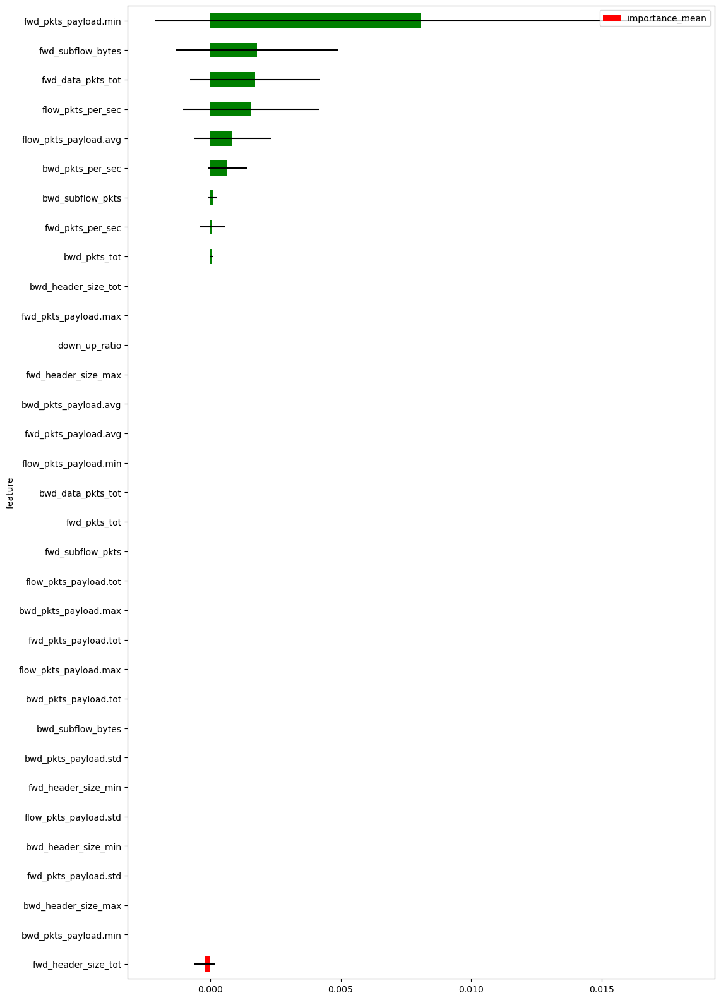

In [144]:
# extract a sample of the data
sample_df = combined_df.sample(frac=0.01, random_state=0)

# define the validation scheme
cv = KFold(n_splits=4, shuffle=False, random_state=None) # Don't shuffle to keep the time split split validation

# define the binary target and the features
dataset = Dataset(df=sample_df, target="is_attack", features=[col for col in combined_df.columns if col != "is_attack"])

# define the validation scheme and scorer. The default model is LightGBM
lofo_imp = LOFOImportance(dataset, cv=cv, scoring="roc_auc")

# get the mean and standard deviation of the importances in pandas format
importance_df = lofo_imp.get_importance()

# plot the means and standard deviations of the importances
plot_importance(importance_df, figsize=(12, 20))

## TreeInterpreter

### How it works
Package for interpreting scikit-learn's decision tree and random forest predictions. Allows decomposing each prediction into bias and feature contribution components as described in http://blog.datadive.net/interpreting-random-forests/. For a dataset with n features, each prediction on the dataset is decomposed as prediction = bias + feature_1_contribution + ... + feature_n_contribution.

### How it applys

### Repository:
- https://github.com/andosa/treeinterpreter

### Paper:
- https://arxiv.org/abs/2010.06734

In [145]:
#!pip install treeinterpreter

In [146]:
from treeinterpreter import treeinterpreter as ti

C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\treeinterpreter\treeinterpreter.py:8: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
C:\Users\ivoafonsobispo\anaconda3\Lib\site-packages\treeinterpreter\treeinterpreter.py:8: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.


In [147]:
#prediction, bias, contributions = ti.predict(model, X_test)

In [148]:
#print("Shape of bias:", bias.shape)
#print("Shape of contributions sum:", np.sum(contributions, axis=1).shape)

In [149]:
#print("Shape of X_test:", X_test.shape)

In [150]:
#assert np.allclose(prediction, bias + np.sum(contributions, axis=1))
#assert np.allclose(model.predict(X_test), bias + np.sum(contributions, axis=0))